# Where To Sell Products - Transformers version

This notebook contains the logic to characterize geographic areas exploiting user generated content in the form of text messages.

## Prepare tweet data

We have twitter data from July to September 2013 for all the world. However, we only have tagged tweets from Los Angeles in the same time period, so we can only train a classifier with that sub set and apply it to the rest.

In [1]:
import os

artifacts_path = os.path.join(os.path.curdir, 'artifacts/')
models_path = os.path.join(artifacts_path, 'models/')
sklearn_models = os.path.join(models_path, 'sklearn/')
kears_modesl = os.path.join(models_path, 'keras/')
results_path = os.path.join(artifacts_path, 'results/')
logs_path = os.path.join(results_path, 'logs/')
data_path = os.path.join(artifacts_path, 'data/')

In [2]:
import pandas as pd
import os

base_path = "/media/ohtar10/Adder-Storage/datasets/twitter/2013/"
# All tweets (contains tweets from July to September 2013)
raw_tweets = pd.read_parquet(os.path.join(base_path, 'full'), engine='pyarrow')
# Los Angeles tweets
la_tweets = raw_tweets.loc[raw_tweets['place_name'] == "Los Angeles"]
# Labels for LA tweets
tweet_labels = pd.read_parquet(os.path.join(base_path, 'labeling-completed/tweet-labels.parquet'), engine='pyarrow')

#### Here are the LA tweets

In [120]:
tweet_labels.shape

(36634, 3)

In [3]:
la_tweets = la_tweets.set_index('id')
la_tweets.head()

,tweet,lang,favorite_count,retweet_count,is_retweet,user_id,user_name,user_followers_count,user_following_count,user_location,...,place_name,place_full_name,country,country_code,place_type,place_url,hour,year,month,day
id,,,,,,,,,,,,,,,,,,,,,
384916747477741568,En route 2 Jakarta for a show w @karminmusic @...,en,0.0,0.0,0.0,93526496,mikafineo,827.0,306.0,Los Angeles,...,Los Angeles,"Los Angeles, CA",United States,US,city,https://api.twitter.com/1.1/geo/id/3b77caf94bf...,0,2013,10,1
384916885872984065,There should be school tomorrow.,en,0.0,0.0,0.0,45670723,Arjun_Multani,83.0,79.0,,...,Los Angeles,"Los Angeles, CA",United States,US,city,https://api.twitter.com/1.1/geo/id/3b77caf94bf...,0,2013,10,1
384917057852043264,@rhud88 I can honestly say I have no idea when...,en,0.0,0.0,0.0,226453903,mardyballin,553.0,196.0,,...,Los Angeles,"Los Angeles, CA",United States,US,city,https://api.twitter.com/1.1/geo/id/3b77caf94bf...,0,2013,10,1
384916520993714176,So excited for tomorrow @AriShaffir @joerogan ...,en,0.0,0.0,0.0,383386931,SusiePlascencia,577.0,477.0,Los Angeles,...,Los Angeles,"Los Angeles, CA",United States,US,city,https://api.twitter.com/1.1/geo/id/3b77caf94bf...,0,2013,10,1
384919230505701377,Kiss my forehand #SoIKnowItsReal 😂,en,0.0,0.0,0.0,269026097,brandonxsanchez,711.0,519.0,Los Angeles,...,Los Angeles,"Los Angeles, CA",United States,US,city,https://api.twitter.com/1.1/geo/id/3b77caf94bf...,0,2013,10,1


#### And their corresponding labels

In [4]:
tweet_labels = tweet_labels.set_index('id')
tweet_labels.head()

,tweet,category,other
id,,,
383319220961828867,english boy writes with his notebook positione...,other_topic,writing ways
383294856249888768,"The girls i talk to are like the jobs i get, i...",other_topic,relationships
383099313616060416,This I'd what sister are for. @ jolly-hill htt...,na,None
383357888271360000,UOENO,na,None
383358030852550657,@russmillerdrums thanks for taking time to tal...,na,None


So now we can join them and have a tagged data frame of LA tweets

In [5]:
tweets = tweet_labels.loc[:, ['category', 'other']].join(la_tweets, on='id', how='inner')
tweets.head()

,category,other,tweet,lang,favorite_count,retweet_count,is_retweet,user_id,user_name,user_followers_count,...,place_name,place_full_name,country,country_code,place_type,place_url,hour,year,month,day
id,,,,,,,,,,,,,,,,,,,,,
383319220961828867,other_topic,writing ways,english boy writes with his notebook positione...,en,0.0,0.0,0.0,188512561,Normuffin,243.0,...,Los Angeles,"Los Angeles, CA",United States,US,city,https://api.twitter.com/1.1/geo/id/3b77caf94bf...,14,2013,9,26
383294856249888768,other_topic,relationships,"The girls i talk to are like the jobs i get, i...",en,0.0,0.0,0.0,1444304432,ramirezjerson23,87.0,...,Los Angeles,"Los Angeles, CA",United States,US,city,https://api.twitter.com/1.1/geo/id/3b77caf94bf...,13,2013,9,26
383099313616060416,na,None,This I'd what sister are for. @ jolly-hill htt...,en,0.0,0.0,0.0,105921479,NaniJolly,13.0,...,Los Angeles,"Los Angeles, CA",United States,US,city,https://api.twitter.com/1.1/geo/id/3b77caf94bf...,0,2013,9,26
383357888271360000,na,None,UOENO,pt,0.0,0.0,0.0,233651062,Shawwa24,149.0,...,Los Angeles,"Los Angeles, CA",United States,US,city,https://api.twitter.com/1.1/geo/id/3b77caf94bf...,17,2013,9,26
383358030852550657,na,None,@russmillerdrums thanks for taking time to tal...,en,0.0,0.0,0.0,25229033,AustinElrod4,270.0,...,Los Angeles,"Los Angeles, CA",United States,US,city,https://api.twitter.com/1.1/geo/id/3b77caf94bf...,17,2013,9,26


## Category distribution

Let's observe the category distribution of this data set

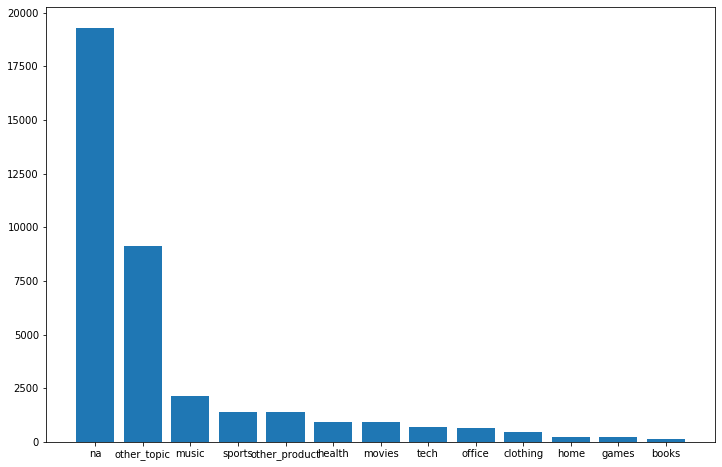

In [6]:
import matplotlib.pyplot as plt

categories = tweets['category'].str.split(',').explode().apply(lambda value: value.strip() if isinstance(value, str) else value).value_counts()
plt.figure(figsize=(12, 8))
plt.bar(categories.index, categories)
plt.show()


It seems we have a heavily unbalance data set. However, from the tagging definition, we know that the ones categorized with 'na' means that the message do not carry enough or useful information, so we can simply discard them. Furthermore, 'other_topic' is meant to be about topics not strictly related to commerce products, so we can discard this category as well. This will leave us with eleven categories, let's see how this shows then.

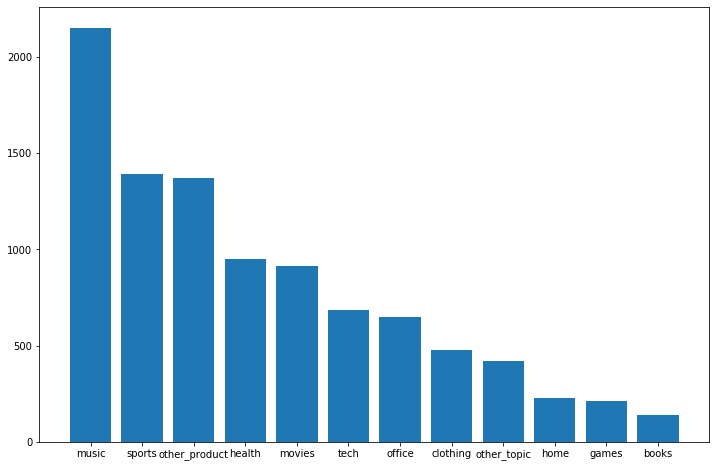

In [7]:
filters = ["home", "office", "music", "health", "tech", "clothing", "games", "books", "movies", "sports", 'other_product']

def category_match(string, filters):
    categories = string.split(',')
    categories = [c.strip() for c in categories]
    if set(categories).intersection(filters):
        return True
    return False

tweets = tweets.loc[tweets['category'].apply(category_match, args=[filters])]

categories = tweets['category'].str.split(',').explode().apply(lambda value: value.strip() if isinstance(value, str) else value).value_counts()
plt.figure(figsize=(12, 8))
plt.bar(categories.index, categories)
plt.show()

We still have an unbalanced data set, but looks much better than before, so this will be our data set for training.

In [8]:
tweets.shape

(8691, 30)

In [9]:
total = tweets.shape[0]
music = categories['music']
print(f"Baseline: {music/total:.2f}")

Baseline: 0.25


## Visualize the tweets in a map

First, we need to parse the geometries informed in each tweet.

In [10]:
from shapely import wkt
import geopandas as gpd

# Some tweets might have appear without place or location geometry
tweets = tweets[(tweets.place_geometry.notnull()) | (tweets.location_geometry.notnull())]

def parse_geometry(geom):
    if geom:
        return wkt.loads(geom)
    else:
        return None

tweets.location_geometry = tweets.location_geometry.apply(parse_geometry)
tweets.place_geometry = tweets.place_geometry.apply(parse_geometry)

# Let's work first with the location geometry first
geo_tweets = gpd.GeoDataFrame(tweets, geometry='location_geometry')
geo_tweets.head()

,category,other,tweet,lang,favorite_count,retweet_count,is_retweet,user_id,user_name,user_followers_count,...,place_name,place_full_name,country,country_code,place_type,place_url,hour,year,month,day
id,,,,,,,,,,,,,,,,,,,,,
383430944650055680,sports,None,#WeLoveLA Pat Haden meets with NCAA to seek ea...,en,0.0,0.0,0.0,748959852,LosAngelesSRH,200.0,...,Los Angeles,"Los Angeles, CA",United States,US,city,https://api.twitter.com/1.1/geo/id/3b77caf94bf...,22,2013,9,26
383303035138482176,tech,None,I had like perfect internet service and then i...,en,0.0,0.0,0.0,188512561,Normuffin,243.0,...,Los Angeles,"Los Angeles, CA",United States,US,city,https://api.twitter.com/1.1/geo/id/3b77caf94bf...,13,2013,9,26
383292826219335681,music,None,Oh! Got it :) “@_R0YAL_: @cy_dieyi d legoo is ...,en,0.0,0.0,0.0,70805633,CY_Dieyi,813.0,...,Los Angeles,"Los Angeles, CA",United States,US,city,https://api.twitter.com/1.1/geo/id/3b77caf94bf...,13,2013,9,26
383322559640379392,music,None,We were us is my song right now !❤️❤️❤️❤️❤️❤️❤️,en,0.0,0.0,0.0,54985237,Katiee_Clinton,525.0,...,Los Angeles,"Los Angeles, CA",United States,US,city,https://api.twitter.com/1.1/geo/id/3b77caf94bf...,15,2013,9,26
383368197853810688,games,None,“@justincepriano: I don't understand how peopl...,en,0.0,0.0,0.0,1600349232,Frisco_Shazeh,32.0,...,Los Angeles,"Los Angeles, CA",United States,US,city,https://api.twitter.com/1.1/geo/id/3b77caf94bf...,18,2013,9,26


Then, we define a folium function to visualize a heatmap of the tweets in Los Angeles

In [11]:
import folium 
from folium.plugins import HeatMap
import numpy as np

def display_heatmap(center, zoom, geom, radius=20, blur=10, records=-1, random_state=1234):
    if records < 0:
        point_list = [(p.y, p.x) for p in geom.values if p]
    else:
        np.random.seed(random_state)
        indices = np.random.permutation(records)
        point_list = [(p.y, p.x) for p in geom.iloc[indices].values if p]
    
    heatmap = HeatMap(point_list,
                     radius=radius,
                     blur=blur)
    
    m = folium.Map(location=center,
                  zoom_start=zoom,
                  tiles="OpenStreetMap")

    heatmap.add_to(m)
    return m

In [12]:
la_heatmap = display_heatmap(center=(34.1, -118.4),
               zoom=11,
               geom=tweets['location_geometry'].iloc[:1000])
la_heatmap

Now, let's visualize the tweets as individual points with a different color per category

In [13]:
from itertools import cycle
import matplotlib
import matplotlib.pyplot as plt
import numpy as np

def display_elements_on_map(tweets, labels):
    n_labels = len(labels)
    colormap = cycle(plt.cm.rainbow(np.linspace(0, 1, n_labels)))
    colors = {label: matplotlib.colors.to_hex(next(colormap)) for label in labels}
    
    m = folium.Map(location=(34.1, -118.4), 
                zoom_start=11,
                tiles="OpenStreetMap", prefer_canvas=True)
    
    def create_marker(row):
        lat_lon = (row["location_geometry"].y, row["location_geometry"].x)
        label = row["category"]
        color = colors[label] if label in colors else '#000000'

        tooltip = folium.map.Tooltip(text=row.category,
                                    style="color: DodgerBlue")
        folium.CircleMarker(
            location=lat_lon,
            radius=3,
            color=color,
            fill=True,
            fill_color=color,
            fill_opacity=0.1 if label == 'na' else 0.5,
            stroke=False,
            tooltip=tooltip).add_to(m)
    
    tweets.apply(create_marker, axis=1)
    
    return m

la_cl_map = display_elements_on_map(tweets.loc[tweets['location_geometry'].notnull()][:10000], filters)
la_cl_map

Looks good! Now, let's perform the geospatial clustering

### Select the best Hyperparameters for DBSCAN

Resource: https://towardsdatascience.com/machine-learning-clustering-dbscan-determine-the-optimal-value-for-epsilon-eps-python-example-3100091cfbc

The most important parameters in DBSCAN are:
* Epsilon (eps): The maxmun distance between points to be considered neighbors.
* min_samples: The minimum number of instances for them to be considered as a cluster.

We need to validate what are the best values for these properties. For this, we need to train the model several times with different option values and track the results to finally observe what is the best combination.

First, let's visualize the points as they are to have an idea of the possible value for $k$ i.e., the number of neighbors for the cluster.

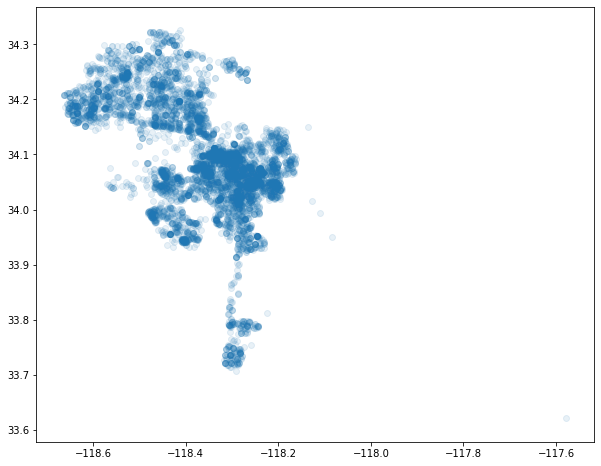

In [14]:
import numpy as np

points = tweets.loc[tweets['location_geometry'].notnull()]['location_geometry'].apply(lambda p: [p.x, p.y])
points = np.array(points.values.tolist())
points.shape

plt.figure(figsize=(10, 8))
plt.scatter(points[:, 0], points[:, 1], alpha=0.1)
plt.show()

We can observe small groups of points, though they are do not seem very well defined. We should not pick a value too high for $k$, hence let's continue with $k=5$.

Now, let's evaluate what is the best value for $eps$.

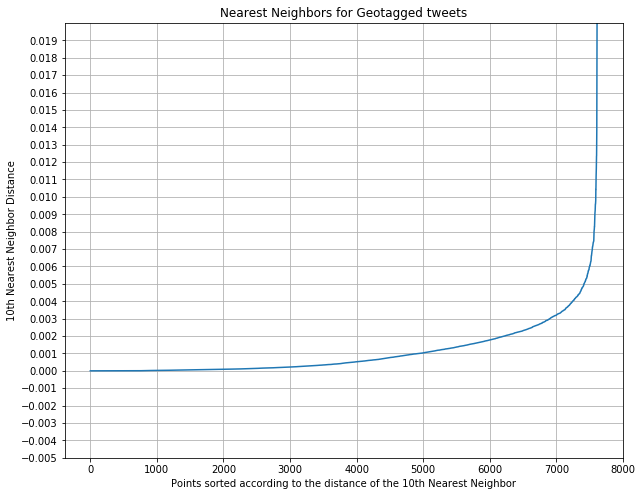

CPU times: user 362 ms, sys: 7.1 ms, total: 369 ms
Wall time: 386 ms


In [15]:
%%time

from sklearn.neighbors import NearestNeighbors

def plot_nearest_neighbors(X, n_neighbors=2):
    neigh = NearestNeighbors(n_neighbors=n_neighbors)
    nbrs = neigh.fit(X)
    distances, indices = nbrs.kneighbors(X)
    distances = np.sort(distances, axis=0)
    distances = distances[:,1]
    
    plt.figure(figsize=(10, 8))
    plt.grid()
    axes = plt.gca()
    axes.set_ylim([-0.005, 0.02])
    plt.yticks(np.arange(-0.005, 0.02, 0.001))
    plt.title("Nearest Neighbors for Geotagged tweets")
    plt.ylabel(f"{n_neighbors}th Nearest Neighbor Distance")
    plt.xlabel(f"Points sorted according to the distance of the {n_neighbors}th Nearest Neighbor")
    plt.plot(distances)
    plt.show()

plot_nearest_neighbors(points, 10)

According to the Nearest Neighbor analysis, for `k=10` the best distance would be $0.004$. Let's use these values as eps.

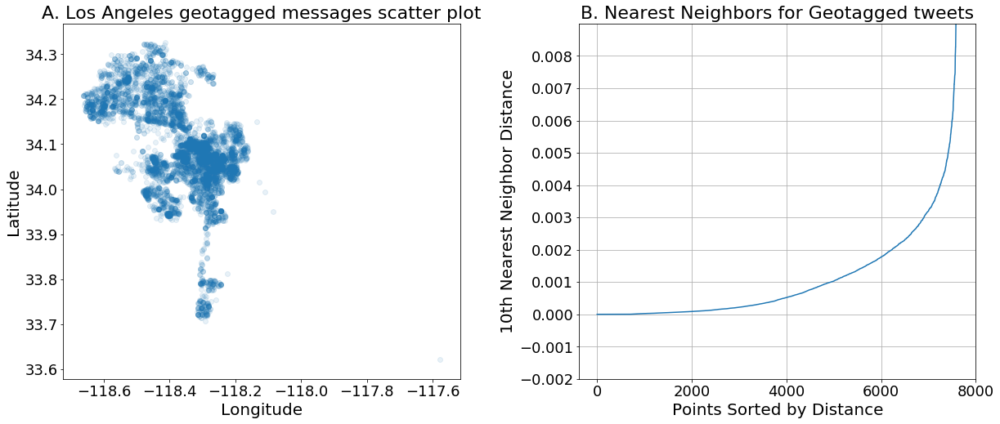

In [16]:
base_fontsize = 18
title_fontsize = base_fontsize + 4
labels_fontsize = base_fontsize + 2
ticks_fontsize = base_fontsize

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(20, 8))
plt.subplots_adjust(wspace=0.3)
#fig.tight_layout()
axs = axs.flatten()

# Scatter plot
axs[0].scatter(points[:, 0], points[:, 1], alpha=0.1)
axs[0].set_title("A. Los Angeles geotagged messages scatter plot", fontsize=title_fontsize)
axs[0].tick_params(labelsize=ticks_fontsize)
axs[0].set_xlabel("Longitude", fontsize=labels_fontsize)
axs[0].set_ylabel("Latitude", fontsize=labels_fontsize)

# Nearest neighbors
n_neighbors = 10
neigh = NearestNeighbors(n_neighbors=n_neighbors)
nbrs = neigh.fit(points)
distances, indices = nbrs.kneighbors(points)
distances = np.sort(distances, axis=0)
distances = distances[:,1]

axs[1].grid()
axs[1].set_ylim([-0.002, 0.009])
axs[1].set_yticks(np.arange(-0.002, 0.009, 0.001))
axs[1].tick_params(labelsize=ticks_fontsize)
axs[1].set_title("B. Nearest Neighbors for Geotagged tweets", fontsize=title_fontsize)
axs[1].set_ylabel(f"{n_neighbors}th Nearest Neighbor Distance", fontsize=labels_fontsize)
axs[1].set_xlabel(f"Points Sorted by Distance", fontsize=labels_fontsize)
axs[1].plot(distances)

In [17]:
%%time
from sklearn.cluster import OPTICS
from sklearn import metrics
import pickle

optics_path = os.path.join(sklearn_models, 'optics.pkl')
optics = None
if os.path.exists(optics_path):
    with open(optics_path, 'rb') as file:
        optics = pickle.load(file)
else:
    optics = OPTICS(cluster_method="dbscan",
                    eps=0.002,
                    min_samples=10,
                    metric="minkowski",
                    n_jobs=-1).fit(points)
    with open(optics_path, 'wb') as file:
        pickle.dump(optics, file)

CPU times: user 3.5 ms, sys: 11.4 ms, total: 14.9 ms
Wall time: 24.3 ms


Let's calculate some metrics

In [18]:
from sklearn import metrics

la_clusters = optics
labels = la_clusters.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

print('#' * 20)
print('Including the noise')
print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)
print("Silhouette Coefficient: %0.3f"
      % metrics.silhouette_score(points, labels))
print('#' * 20)
print('Excluding the noise')
qpoints, qlabels = list(zip(*[(p, l) for p, l in zip(points, labels) if l != -1]))
print("Silhouette Coefficient: %0.3f"
      % metrics.silhouette_score(qpoints, qlabels))

####################
Including the noise
Estimated number of clusters: 116
Estimated number of noise points: 3366
Silhouette Coefficient: -0.217
####################
Excluding the noise
Silhouette Coefficient: 0.335


And now, let's plot the clusters on a map

In [19]:
from itertools import cycle
import matplotlib
import matplotlib.pyplot as plt
import numpy as np

def display_clusters_on_map(tweets, clusters, limit=10000):
    tweets["cluster"] = clusters
    n_clusters = np.unique(clusters).shape[0]
    colormap = cycle(plt.cm.rainbow(np.linspace(0, 1, n_clusters)))
    colors = {k: matplotlib.colors.to_hex(next(colormap)) for k in range(n_clusters)}
    colors[-1] = '#000000'
    
    m = folium.Map(location=(34.1, -118.4), 
                zoom_start=11,
                tiles="OpenStreetMap", prefer_canvas=True)
    
    def create_marker(row):
        lat_lon = (row["location_geometry"].y, row["location_geometry"].x)
        cluster = row["cluster"]
        color = colors[cluster]

        tooltip = folium.map.Tooltip(text=cluster,
                                    style="color: DodgerBlue")

        folium.CircleMarker(
            location=lat_lon,
            radius=3,
            color=color,
            fill=True,
            fill_color=color,
            fill_opacity=0.5 if cluster != -1 else 0.15,
            stroke=False,
            tooltip=tooltip).add_to(m)
    
    tweets[:limit].apply(create_marker, axis=1)
    
    return m

la_cl_map = display_clusters_on_map(tweets[tweets['location_geometry'].notnull()], la_clusters.labels_)
la_cl_map

Looks godd! Now for the category prediction

# Tweets product category prediction
Here we are going to train the product classifier model to predict a relationship between the clusters and the products and give a characteristic to the geographic clusters found.

## Tweet Pre-processing
First, we need to pre-process the tweets we have available for classification. This means the cleaning and tokenization of words using the trained dictionary we have from the reviews classifier.


In [20]:
from sklearn.base import BaseEstimator, TransformerMixin
from nltk.tokenize import RegexpTokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
import pickle
import re

class DocumentTokenizer(BaseEstimator, TransformerMixin):

    def __init__(self, corpus_column: str, 
                lowercase: bool = True,
                maxlen=None,
                word_index=None,
                split_regex=r'\s+',
                clean_regex=r"[?!\(\)\"'#@\$%\^&\*\-\_|+=\[\{\}\],\.\?/<>~¿]"):
        self.corpus_column = corpus_column
        self.lowercase = lowercase
        self.maxlen = maxlen
        self.word_index = word_index
        self.split_regex = split_regex
        self.clean_regex = clean_regex

    def fit(self, X, y=None):
        return self # Do nothing

    def transform(self, X, y=None):
        def tokenize(row):
            words = re.split(self.split_regex, row[self.corpus_column].lower())
            words = [re.sub(self.clean_regex, '', word) for word in words]
            words = [word.strip() for word in words if len(word.strip()) > 0]
            tokens = [self.word_index[w] for w in words if w in self.word_index][:self.maxlen]
            return [0] * (self.maxlen - len(tokens)) + tokens
        
        return X.apply(tokenize, axis=1, result_type='expand').values

#### Important
For tweet classification we have only 8000 tweets, so we need to do data augmentation in order to get bigger data set.

In [21]:
from sklearn.model_selection import train_test_split

to_aug, no_aug = train_test_split(tweets, test_size=0.2, random_state=1234)

In [22]:
# augmented_tweets = pd.read_parquet(os.path.join(artifacts_path, 'tweets/all_tweets.parquet'))

# emb_insert = pd.read_parquet(os.path.join(artifacts_path, 'tweets/tweets_emb_insert.parquet'))
# emd_subs = pd.read_parquet(os.path.join(artifacts_path, 'tweets/tweets_emb_subs.parquet'))
ctx_insert = pd.read_parquet(os.path.join(artifacts_path, 'tweets/tweets_ctx_insert_aug.parquet'))
ctx_subs = pd.read_parquet(os.path.join(artifacts_path, 'tweets/tweets_ctx_substitute_aug.parquet'))
ctx_sent = pd.read_parquet(os.path.join(artifacts_path, 'tweets/tweets_ctx_sent_aug.parquet'))

augmented_tweets = pd.concat([to_aug, ctx_insert, ctx_subs, ctx_sent])

augmented_tweets = augmented_tweets[augmented_tweets['tweet'].notna()]

In [23]:
train, test = train_test_split(augmented_tweets, test_size=0.2, random_state=4321)
dev, test = train_test_split(test, test_size=0.5, random_state=4321)

In [24]:
import pickle 

word_index_path = os.path.join(data_path, 'word_index.pkl')
with open(word_index_path, 'rb') as file:
    word_index = pickle.load(file)

In [25]:
%%time
tokenizer = DocumentTokenizer('tweet', maxlen=300, word_index=word_index)
X_train = tokenizer.transform(train)
X_dev = tokenizer.transform(dev)
X_test = tokenizer.transform(test)
X_noaug = tokenizer.transform(no_aug)

CPU times: user 20.4 s, sys: 180 ms, total: 20.6 s
Wall time: 20.5 s


Now, we need to train a category encoder since this data set has different label names.

In [26]:
from sklearn.preprocessing import MultiLabelBinarizer
import pickle

categories = tweets['category'].apply(lambda cat: [c.strip() for c in cat.split(",")]).values.tolist()

categories_encoder_path = os.path.join(sklearn_models, 'category_encoder_tweets.pkl')
categories_encoder = None
if os.path.exists(categories_encoder_path):
    with open(categories_encoder_path, 'rb') as file:
        categories_encoder = pickle.load(file)
else:
    categories_encoder = MultiLabelBinarizer()
    categories_encoder.fit(categories)
    with open(categories_encoder_path, 'wb') as file:
        pickle.dump(categories_encoder, file)

Now we can obtain the encoded labels for training

In [27]:
categories = train['category'].apply(lambda cat: [c.strip() for c in cat.split(",")]).values.tolist()
y_train = categories_encoder.transform(categories)

categories = dev['category'].apply(lambda cat: [c.strip() for c in cat.split(",")]).values.tolist()
y_dev = categories_encoder.transform(categories)

categories = test['category'].apply(lambda cat: [c.strip() for c in cat.split(",")]).values.tolist()
y_test = categories_encoder.transform(categories)

categories = no_aug['category'].apply(lambda cat: [c.strip() for c in cat.split(",")]).values.tolist()
y_noaug = categories_encoder.transform(categories)

In [28]:
augmented_tweets.shape

(83758, 31)

## Transfer Learning with the reviews classifier

Since we have very few training examples, our best chance to achieve a decent score is to use transfer learning from our reviews model which achieved a good performance. The transformer model already contains trained layers to extract features from review text, now we will transfer that knowledge by freezing those the attention and embedding layers and train a new fully connected model on-top of the attention layers.

In [29]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
  try:
    # Currently, memory growth needs to be the same across GPUs
    for gpu in gpus:
      tf.config.experimental.set_memory_growth(gpu, True)
    #   tf.config.experimental.set_virtual_device_configuration(
    #         gpu, [tf.config.experimental.VirtualDeviceConfiguration(memory_limit=6144)]
    #   )
    logical_gpus = tf.config.experimental.list_logical_devices('GPU')
    print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
  except RuntimeError as e:
    # Memory growth must be set before GPUs have been initialized
    print(e)

1 Physical GPUs, 1 Logical GPUs


In [30]:
class MultiHeadSelfAttention(layers.Layer):
    def __init__(self, embed_dim, num_heads=8):
        super(MultiHeadSelfAttention, self).__init__()
        self.embed_dim = embed_dim
        self.num_heads = num_heads
        if embed_dim % num_heads != 0:
            raise ValueError(
                f"embedding dimmension = {embed_dim} should be divisible by number of heads = {num_heads}"
            )
        self.projection_dim = embed_dim // num_heads
        self.query_dense = layers.Dense(embed_dim)
        self.key_dense = layers.Dense(embed_dim)
        self.value_dense = layers.Dense(embed_dim)
        self.combine_heads = layers.Dense(embed_dim)

    def attention(self, query, key, value):
        score = tf.matmul(query, key, transpose_b=True)
        dim_key = tf.cast(tf.shape(key)[-1], tf.float32)
        scaled_score = score / tf.math.sqrt(dim_key)
        weights = tf.nn.softmax(scaled_score, axis=-1)
        output = tf.matmul(weights, value)
        return output, weights

    def separate_heads(self, x, batch_size):
        x = tf.reshape(x, (batch_size, -1, self.num_heads, self.projection_dim))
        return tf.transpose(x, perm=[0, 2, 1, 3])

    def call(self, inputs):
        # x.shape = [batch_size, seq_len, embedding_dim]
        batch_size = tf.shape(inputs)[0]
        query = self.query_dense(inputs) # (batch_size, seq_len, embed_dim)
        key = self.key_dense(inputs) # (batch_size, seq_len, embed_dim)
        value = self.value_dense(inputs) # (batch_size, seq_len, embed_dim)
        query = self.separate_heads(
            query, batch_size
        ) # (batch_size, num_heads, seq_len, projection_dim)
        key = self.separate_heads(
            query, batch_size
        ) # (batch_size, num_heads, seq_len, projection_dim)
        value = self.separate_heads(
            query, batch_size
        ) # (batch_size, num_heads, seq_len, projection_dim)

        attention, weights = self.attention(query, key, value)
        attention = tf.transpose(
            attention, perm=[0, 2, 1, 3]
        ) # (batch_size, seq_len, embed_dim)
        concat_attention = tf.reshape(
            attention, (batch_size, -1, self.embed_dim)
        ) # (batch_size, seq_len, embed_dim)
        output = self.combine_heads(
            concat_attention
        ) # (batch_size, seq_len, embed_dim)
        return output


In [31]:
class TransformerBlock(layers.Layer):
    def __init__(self, embed_dim, num_heads, ff_dim, dropout_rate=0.1):
        super(TransformerBlock, self).__init__()
        self.att = MultiHeadSelfAttention(embed_dim=embed_dim, num_heads=num_heads)
        self.ffn = keras.Sequential(
            [
                layers.Dense(ff_dim, activation='relu'),
                layers.Dense(embed_dim)
            ]
        )
        self.layernorm1 = layers.LayerNormalization(epsilon=1e-6)
        self.layernorm2 = layers.LayerNormalization(epsilon=1e-6)
        self.dropout1 = layers.Dropout(dropout_rate)
        self.dropout2 = layers.Dropout(dropout_rate)

    def call(self, inputs, training):
        attn_output = self.att(inputs)
        attn_output = self.dropout1(attn_output, training=training)
        out1 = self.layernorm1(inputs + attn_output)
        ffn_output = self.ffn(out1)
        ffn_output = self.dropout2(ffn_output, training=training)
        return self.layernorm2(out1 + ffn_output)

In [32]:
class TokenAndPositionEmbedding(layers.Layer):
    def __init__(self, maxlen, vocab_size, embed_dim):
        super(TokenAndPositionEmbedding, self).__init__()
        self.token_emb = layers.Embedding(input_dim=vocab_size, output_dim=embed_dim, mask_zero=True)
        self.pos_emb = layers.Embedding(input_dim=maxlen, output_dim=embed_dim, mask_zero=True)

    def call(self, x):
        maxlen = tf.shape(x)[-1]
        positions = tf.range(start=0, limit=maxlen, delta=1)
        positions = self.pos_emb(positions)
        x = self.token_emb(x)
        return x + positions

Now let's load the base model. This is the reviews classifier that we already trained. The idea is to do a transfer learning by freezing all but the top fully connected layer so we can implement one specifically for the twitter task.

In [33]:
def build_model(path, maxlen, classes, vocab_size=1000000, embed_dim=128, num_heads=4, ff_dim=64):
    # load the base model and freeze it
    base_model = tf.keras.models.load_model(path, compile=False)
    base_model.trainable = False

    inputs = layers.Input(shape=(maxlen,))
    # From the base model, we are going to use the first three layers
    # with the new input layer
    x = base_model.layers[1](inputs)
    x = base_model.layers[2](x)

    # new model
    
    x = layers.Conv1D(128, 5, activation='relu')(x)
    x = layers.MaxPool1D(2, strides=2, padding='valid')(x)

    x = layers.Conv1D(64, 3, activation='relu')(x)
    x = layers.MaxPool1D(2, strides=2, padding='valid')(x)

    # x = layers.Conv1D(64, 3, activation='relu')(x)
    # x = layers.MaxPool1D(2, strides=2, padding='valid')(x)

    x = layers.Flatten()(x)

    x = layers.Dense(1024, activation='relu')(x)
    x = layers.Dropout(0.2)(x)
    # x = layers.Dense(1024, activation='relu')(x)
    # x = layers.Dropout(0.3)(x)
    # x = layers.Dense(512, activation='relu')(x)
    # x = layers.Dropout(0.2)(x)
    # x = layers.Dense(512, activation='relu')(x)
    # x = layers.Dropout(0.2)(x)
    x = layers.Dense(512, activation='relu')(x)
    x = layers.Dropout(0.1)(x)
    x = layers.Dense(256, activation='tanh')(x)
    # x = layers.Dropout(0.1)(x)
    # x = layers.Dense(128, activation='tanh')(x)

    outputs = layers.Dense(classes, activation='softmax')(x)

    model = keras.Model(inputs=inputs, outputs=outputs)
    return model

keras_model_path = os.path.join(kears_modesl, 'tweets-classifier')
is_twitter_model_trained = False
if os.path.exists(keras_model_path):
    model = tf.keras.models.load_model(keras_model_path)
    is_twitter_model_trained = True
else:
    base_model_path = os.path.join(kears_modesl, 'reviews-classifier')
    model = build_model(base_model_path, 300, y_train.shape[1])

Finally, let's define our own fully connected layers for our specific task

In [34]:
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 300)]             0         
_________________________________________________________________
token_and_position_embedding (None, 300, 128)          128038400 
_________________________________________________________________
transformer_block (Transform (None, 300, 128)          83136     
_________________________________________________________________
conv1d (Conv1D)              (None, 296, 128)          82048     
_________________________________________________________________
max_pooling1d (MaxPooling1D) (None, 148, 128)          0         
_________________________________________________________________
conv1d_1 (Conv1D)            (None, 146, 64)           24640     
_________________________________________________________________
max_pooling1d_1 (MaxPooling1 (None, 73, 64)            0     

In [35]:
from sklearn.utils.class_weight import compute_class_weight

number_dim = y_train.shape[1]
weights = np.empty([number_dim, 2])
for i in range(number_dim):
    weights[i] = compute_class_weight('balanced', [0., 1.], y_train[:, i])


In [36]:
%%time
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, TensorBoard, ModelCheckpoint


checkpoints_path = os.path.join(results_path, 'checkpoints/')
logs_path = os.path.join(results_path, 'logs/')
callbacks = [
    EarlyStopping(monitor='val_loss', patience=3, min_delta=1e-7, restore_best_weights=True),
    TensorBoard(log_dir=logs_path),
    ModelCheckpoint(checkpoints_path, monitor='val_accuracy')
]

optimizer = Adam(learning_rate=1e-3)


model.compile(optimizer="adam", loss='kullback_leibler_divergence', metrics=['accuracy'])
history = model.fit(X_train, y_train, batch_size=64, epochs=100, validation_data=(X_dev, y_dev), callbacks=callbacks)

Train on 67006 samples, validate on 8376 samples
Epoch 1/100
66752/67006 [============================>.] - ETA: 0s - loss: 1.8545 - accuracy: 0.4968WARNING:tensorflow:Skipping full serialization of Keras model <tensorflow.python.keras.saving.saved_model.load.Sequential object at 0x7fee3af202d0>, because its inputs are not defined.
Instructions for updating:
If using Keras pass *_constraint arguments to layers.
INFO:tensorflow:Assets written to: ./artifacts/results/checkpoints/assets
67006/67006 [==============================] - 21s 310us/sample - loss: 1.8537 - accuracy: 0.4969 - val_loss: 1.5912 - val_accuracy: 0.5943
Epoch 2/100
66816/67006 [============================>.] - ETA: 0s - loss: 1.4321 - accuracy: 0.6377WARNING:tensorflow:Skipping full serialization of Keras model <tensorflow.python.keras.saving.saved_model.load.Sequential object at 0x7fee3af202d0>, because its inputs are not defined.
INFO:tensorflow:Assets written to: ./artifacts/results/checkpoints/assets
67006/67006 

In [37]:
model.evaluate(X_dev, y_dev)

8376/8376 [==============================] - 2s 203us/sample - loss: 1.3115 - accuracy: 0.6861


[1.3115102958998002, 0.686127]

In [38]:
model.evaluate(X_test, y_test)

8376/8376 [==============================] - 2s 195us/sample - loss: 1.3651 - accuracy: 0.6742


[1.3651199797390754, 0.67418814]

In [39]:
%%time
import numpy as np
from sklearn.metrics import classification_report, accuracy_score

def compute_classification_report(model, X, y):
    y_pred = model.predict(X)
    y_pred_logits = y_pred
    y_pred = np.where(y_pred > 0.5, 1., 0.)

    # compute accuracy score
    acc = accuracy_score(y, y_pred)
    # compute the classification report
    cr = classification_report(y, y_pred)
    return acc, cr
acc, cr = compute_classification_report(model, X_dev, y_dev)

CPU times: user 1.73 s, sys: 103 ms, total: 1.84 s
Wall time: 1.69 s


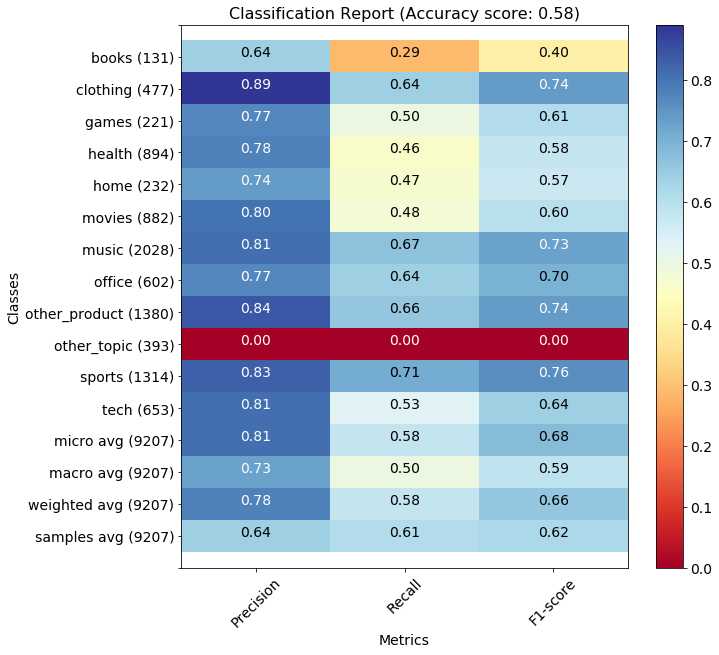

In [40]:
import matplotlib.pyplot as plt
import re
import itertools

def plot_classification_report(title, cr, class_labels):
    cmap="RdYlBu"

    cr = cr.replace("\n\n", "\n")
    cr = cr.replace(" / ", "/")
    lines = cr.split("\n")

    classes, plot_mat, support = [], [], []
    for line in lines[1:]:
        t = re.findall(r'(\s?\w+\s\w+\s?|\s?\d+\.?\d*\s?)', line)
        t = [i.strip() for i in t]
        if len(t) < 2:
            continue

        if t[0].isnumeric():
            cl_id = int(t[0])
            classes.append(class_labels[cl_id])
        else:
            classes.append(t[0])

        v = [float(x) for x in t[1: len(t) - 1]]
        support.append(int(t[-1]))
        plot_mat.append(v)

    plot_mat = np.array(plot_mat)
    x_tick_labels = ["Precision", "Recall", "F1-score"]
    y_tick_labels = [""] + [f"{classes[idx]} ({sup})" for idx, sup in enumerate(support)] + [""]

    plt.figure(figsize=(10, 10))
    plt.title(title, fontsize=16)

    plt.imshow(plot_mat, interpolation="nearest", cmap=cmap, aspect="auto")
    cb = plt.colorbar()
    cb.ax.tick_params(labelsize=14)

    plt.xticks(np.arange(3), x_tick_labels, rotation=45, fontsize=14)
    start = -1
    stop = len(classes) + 1
    y_ticks = np.arange(start, stop, 1)
    plt.yticks(y_ticks, y_tick_labels, fontsize=14)

    upper_threshold = plot_mat.min() + (plot_mat.max() - plot_mat.min()) / 10 * 8
    lower_threshold = plot_mat.min() + (plot_mat.max() - plot_mat.min()) / 10 * 2

    for i, j in itertools.product(range(plot_mat.shape[0]), range(plot_mat.shape[1])):
        text = f"{plot_mat[i, j]:.2f}"
        color = "white" if plot_mat[i, j] > upper_threshold or plot_mat[i, j] < lower_threshold else "black"
        ax = plt.text(j, i, text, fontsize=14,
                        horizontalalignment="center",
                        color=color)

    plt.ylabel("Classes", fontsize=14)
    plt.xlabel("Metrics", fontsize=14)
    plt.show()

class_labels = categories_encoder.classes_
title = f"Classification Report (Accuracy score: {acc:.2f})"
plot_classification_report(title, cr, class_labels)

Let's do a round of fine tunning and make the whole model trainable

In [41]:
%%time
model.trainable = True
optimizer = Adam(learning_rate=1e-6)
model.compile(optimizer="adam", loss='kullback_leibler_divergence', metrics=['accuracy'])
history = model.fit(X_train, y_train, batch_size=64, epochs=100, validation_data=(X_dev, y_dev), callbacks=callbacks)

Train on 67006 samples, validate on 8376 samples
Epoch 1/100
66944/67006 [============================>.] - ETA: 0s - loss: 0.8098 - accuracy: 0.8141WARNING:tensorflow:Skipping full serialization of Keras model <tensorflow.python.keras.saving.saved_model.load.Sequential object at 0x7fee3af202d0>, because its inputs are not defined.
INFO:tensorflow:Assets written to: ./artifacts/results/checkpoints/assets
67006/67006 [==============================] - 82s 1ms/sample - loss: 0.8094 - accuracy: 0.8142 - val_loss: 1.0821 - val_accuracy: 0.7524
Epoch 2/100
66944/67006 [============================>.] - ETA: 0s - loss: 0.5754 - accuracy: 0.8739WARNING:tensorflow:Skipping full serialization of Keras model <tensorflow.python.keras.saving.saved_model.load.Sequential object at 0x7fee3af202d0>, because its inputs are not defined.
INFO:tensorflow:Assets written to: ./artifacts/results/checkpoints/assets
67006/67006 [==============================] - 82s 1ms/sample - loss: 0.5753 - accuracy: 0.8739

In [42]:
model.evaluate(X_dev, y_dev)

8376/8376 [==============================] - 2s 201us/sample - loss: 0.9807 - accuracy: 0.8000


[0.9806664131204629, 0.80002385]

In [43]:
model.evaluate(X_test, y_test)

8376/8376 [==============================] - 2s 196us/sample - loss: 1.0375 - accuracy: 0.7875


[1.0374947711184919, 0.78748804]

In [44]:
model.evaluate(X_noaug, y_noaug)

1739/1739 [==============================] - 0s 207us/sample - loss: 0.4160 - accuracy: 0.9281


[0.415967497021354, 0.9281196]

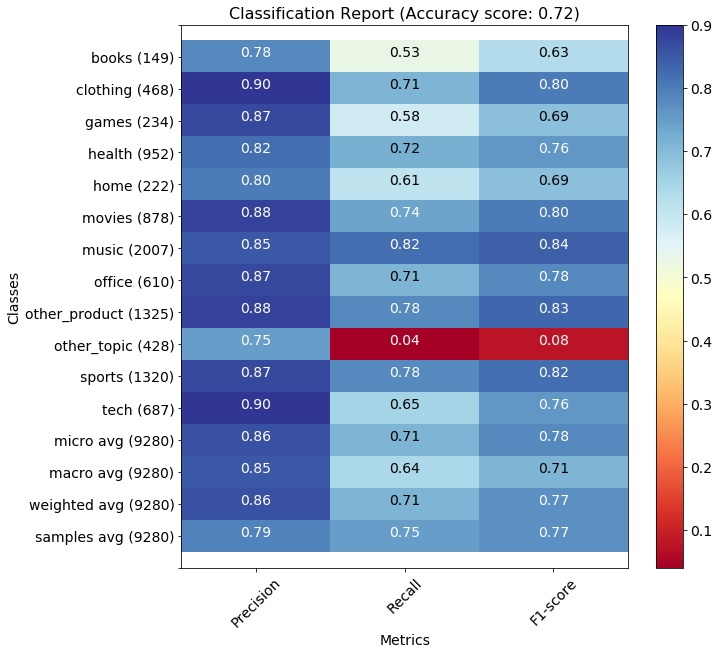

In [46]:
acc, cr = compute_classification_report(model, X_test, y_test)
class_labels = categories_encoder.classes_
title = f"Classification Report (Accuracy score: {acc:.2f})"
plot_classification_report(title, cr, class_labels)

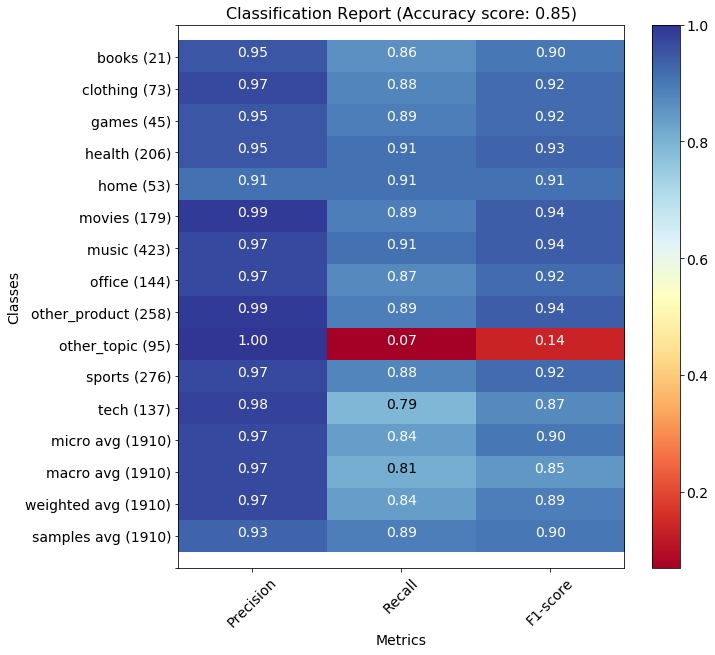

In [47]:
acc, cr = compute_classification_report(model, X_noaug, y_noaug)
class_labels = categories_encoder.classes_
title = f"Classification Report (Accuracy score: {acc:.2f})"
plot_classification_report(title, cr, class_labels)

In [72]:
# Avoid for now as the model cant be loaded back in 2.1.0
# model.save(os.path.join(kears_modesl, 'tweets-classifier'))

Let's do some error analysis and try to understand where the model is failing.

In [48]:
y_pred = model.predict(X_dev)
y_pred_logits = y_pred
y_pred = np.where(y_pred > 0.5, 1., 0.)
errors = [not np.array_equal(y_t, y_p) for y_t, y_p in zip(y_dev, y_pred)]
X_error = X_dev[errors]
y_error = y_pred[errors]
y_error_logits = np.round(y_pred_logits[errors], decimals=2)
tweets_error = dev[errors][['tweet', 'category']]
tweets_error['predicted'] = categories_encoder.inverse_transform(y_error)
tweets_error['pred_logits'] = y_error_logits.tolist()
tweets_error.loc[:, 'pred_logits'] = tweets_error.loc[:, 'pred_logits'].apply(lambda logits: [round(l, 2) for l in logits])

In [49]:
tweets_error

,tweet,category,predicted,pred_logits
5650,@ me _ _ or @ taylorjanee45 and... but i'sm ne...,other_product,(),"[0.0, 0.05, 0.01, 0.36, 0.02, 0.04, 0.32, 0.01..."
6086,"people at work thinking of "" have a good life ...","office,sports","(sports,)","[0.0, 0.0, 0.01, 0.01, 0.0, 0.0, 0.02, 0.2, 0...."
38,Custom black crystal glass chandeliers. #Check...,home,(),"[0.0, 0.0, 0.0, 0.27, 0.42, 0.0, 0.25, 0.0, 0...."
6265,@ com...,health,"(music,)","[0.0, 0.03, 0.01, 0.07, 0.01, 0.06, 0.58, 0.04..."
13036,his kcon is so...,music,(),"[0.0, 0.03, 0.01, 0.14, 0.01, 0.05, 0.44, 0.05..."
...,...,...,...,...
23619,someone loving you my @ toryburch my bedazzler...,other_product,"(home,)","[0.0, 0.0, 0.02, 0.12, 0.75, 0.0, 0.01, 0.0, 0..."
5369,see # 2 nothing more... # 9 ( @ fight night or...,music,"(sports,)","[0.0, 0.0, 0.0, 0.08, 0.0, 0.0, 0.01, 0.0, 0.0..."
4310,# course record,sports,"(music,)","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.97, 0.0, 0.0,..."
4853,""" @ louis _ tomlinson : they can'id t possibly...",music,(),"[0.0, 0.0, 0.07, 0.0, 0.0, 0.0, 0.46, 0.0, 0.0..."


In [83]:
np.array(tweets_error.iloc[-2]['pred_logits'])

array([0.  , 0.  , 0.07, 0.  , 0.  , 0.  , 0.46, 0.  , 0.  , 0.  , 0.47,
       0.  ])

# Clustering Aggregation and Classification - Approach 1 (Aggregate cluster text prior classification)
In this section of the notebook the idea is to use the tweet classification model to predict the categories of aggregated geo spatial cluster corpora and display the results on a map.

## First, let's add the cluster classification to every single tweet in our data set

In [84]:
tweets.shape

(8691, 30)

In [85]:
clustered_tweets = tweets[tweets['location_geometry'].notnull()]
clustered_tweets.loc[:, 'cluster'] = la_clusters.labels_
clustered_tweets = clustered_tweets[["cluster", "location_geometry", "tweet", 'category']]
clustered_tweets = clustered_tweets[clustered_tweets.cluster != -1]
clustered_tweets.head()

,cluster,location_geometry,tweet,category
id,,,,
383430944650055680,0,POINT (-118.28854 34.01361),#WeLoveLA Pat Haden meets with NCAA to seek ea...,sports
383292826219335681,0,POINT (-118.28236 34.03101),Oh! Got it :) “@_R0YAL_: @cy_dieyi d legoo is ...,music
383368197853810688,91,POINT (-118.56850 34.20653),“@justincepriano: I don't understand how peopl...,games
383144905704763392,6,POINT (-118.29150 34.10218),Electric Lotus Indian good here in Los Feliz.....,music
383127851634921472,0,POINT (-118.28243 34.03161),@NDTdance @MusicCenterLA Toi toi toi for NL se...,music


This dictionary is only to map the labels of each category to our display category names

In [86]:
classes = {'books':'Books',
 'clothing': 'Clothing, Shoes & Jewelry',
 'health': 'Health & Personal Care',
 'sports': 'Sports, Fitness & Dieting',
 'home': 'Home & Kitchen',
 'movies': 'Movies & TV',
 'music': 'Music',
 'office': 'Office & School Supplies',
 'tech': 'Technology, Electronics & Accessories',
 'games': 'Toys & Games',
 'other_product': 'Other Products',
 'other_topic': 'Other Topics',
 'na': 'Noise'}

## Define utility functions for pre-processing the data set

In [87]:
from shapely.geometry import Polygon, Point
from scipy.spatial import ConvexHull
import numpy as np

def concatenate_text(sep='\n'):
    """Concatenate Text
    This function will simply join every
    text it receives as a single text and
    separate it by the provide separator.
    Default \n """
    def concat(text):
        return '.\n'.join(text)
    return concat

def to_list(x):
    return list(x)

def calculate_polygon(points):
    """Calculate polygon
    This function will calculate the polygon
    enclosing all the points provided as argument.
    It will use the convex-hull geometric function."""
    points = np.array([list(p.coords[0]) for p in points])
    hull = ConvexHull(points)
    x = points[hull.vertices, 0]
    y = points[hull.vertices, 1]
    boundaries = list(zip(x, y))
    
    return Polygon(boundaries)

def is_valid_polygon(cluster):
    points = cluster.location_geometry.values
    if isinstance(points, Point):
        return False
    if points.shape[0] < 3:
        return False
    coords = np.array([p.coords[0] for p in points])
    upoints = np.unique(coords)
    if upoints.shape[0] < 3:
        return False
    return True

def flat_columns(df, colnames={}):
    df = df.copy()
    df.columns = [''.join(col).strip() for col in df.columns]
    if colnames:
        return df.rename(columns=colnames)
    return df

## Aggregate the tweets by cluster and calculate the corresponding polygon representing it

In [88]:
data = clustered_tweets.groupby("cluster").filter(is_valid_polygon)
data = data.groupby("cluster").agg({'location_geometry': ['count', calculate_polygon],
                            'tweet': [concatenate_text()]})
colnames = {'location_geometrycalculate_polygon': 'polygon', 'location_geometrycount': 'size'}
data = flat_columns(data, colnames)
data.head()

,size,polygon,tweetconcat
cluster,,,
0,168,"POLYGON ((-118.29319 34.03389, -118.29507 34.0...",#WeLoveLA Pat Haden meets with NCAA to seek ea...
1,3,"POLYGON ((-118.28661 34.00079, -118.28765 34.0...",@EASTBAYDFRESH Baseball gods ain't liking you ...
2,18,"POLYGON ((-118.30429 34.02154, -118.30009 34.0...",Ima walk up into school like I'm on my high wa...
3,29,"POLYGON ((-118.28125 34.05117, -118.28802 34.0...",Wifi Crisis day three http://t.co/EkftIFG5bi.\...
4,12,"POLYGON ((-118.28826 34.05443, -118.28834 34.0...",All I ask for is a fucked up sleeping schedule...


## Define a Cluster Class Predictor transformer
This is to make an easier prediction and transition betweent the raw data and the expected output

In [89]:
class ClusterClassPredictor(BaseEstimator, TransformerMixin):

    def __init__(self, model, 
                       tokenizer, 
                       classes, 
                       class_labels, 
                       threshold,
                       exclude_noise=True):
        self.model = model
        self.tokenizer = tokenizer
        self.classes = classes
        self.class_labels = class_labels
        self.threshold = threshold
        self.exclude_noise = exclude_noise

    def fit(self, X, y=None):
        return self # Do nothing

    def __inclusion_fn(self, clazz, score):
        if score > self.threshold:
            if self.exclude_noise and clazz == 'na':
                return False
            else:
                return True
        return False

    def transform(self, X, y=None):
        corpora = self.tokenizer.transform(X)
        predictions = self.model.predict(corpora)
        X['scores'] = predictions.tolist()
        predictions = [list(zip(self.classes, p)) for p in predictions]
        predictions = [[(self.class_labels[c], s) for c, s in p if self.__inclusion_fn(c, s)] for p in predictions]
        predictions = [sorted(p, key=lambda x: x[1], reverse=True) for p in predictions]
        #predictions = [[f'{self.class_labels[c]}: {s * 100:.2f}%' for c, s in p if s > self.threshold] for p in predictions]
        X['predictions'] = predictions
        return X

Here we define a threshold of 0.1 which means that we are going to display only the categories which obtained a score of 0.1 or above.

In [90]:
doc_tokenizer = DocumentTokenizer('tweetconcat', maxlen=300, word_index=word_index)
predictor = ClusterClassPredictor(model, doc_tokenizer, categories_encoder.classes_, classes, 0.05)
predictions = predictor.transform(data)
predictions = predictions.reset_index()
predictions.head()

,cluster,size,polygon,tweetconcat,scores,predictions
0,0,168,"POLYGON ((-118.29319 34.03389, -118.29507 34.0...",#WeLoveLA Pat Haden meets with NCAA to seek ea...,"[2.7340078645465837e-07, 6.73062550049508e-06,...","[(Music, 0.97479385)]"
1,1,3,"POLYGON ((-118.28661 34.00079, -118.28765 34.0...",@EASTBAYDFRESH Baseball gods ain't liking you ...,"[2.2958653289606445e-07, 1.2668313502217643e-0...","[(Sports, Fitness & Dieting, 0.9958312)]"
2,2,18,"POLYGON ((-118.30429 34.02154, -118.30009 34.0...",Ima walk up into school like I'm on my high wa...,"[4.2919047871237126e-08, 2.6670934403227875e-0...","[(Music, 0.99859244)]"
3,3,29,"POLYGON ((-118.28125 34.05117, -118.28802 34.0...",Wifi Crisis day three http://t.co/EkftIFG5bi.\...,"[5.443056352305575e-07, 1.688132033450529e-05,...","[(Music, 0.8702329), (Office & School Supplies..."
4,4,12,"POLYGON ((-118.28826 34.05443, -118.28834 34.0...",All I ask for is a fucked up sleeping schedule...,"[4.4198750970281253e-07, 4.19468460677308e-06,...","[(Music, 0.9487501)]"


## Display the classified clusters on a map

In [91]:
from itertools import cycle
from shapely.geometry import mapping
import folium
import json
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import random

def display_cluster_polygons_on_map(clusters, displayed=[]):
    unique_clusters = np.unique(clusters.cluster.values)
    n_clusters = unique_clusters.shape[0]
    colormap = cycle(plt.cm.rainbow(np.linspace(0, 1, n_clusters)))
    colors = [matplotlib.colors.to_hex(next(colormap)) for _ in range(len(unique_clusters))]
    random.shuffle(colors)
    colors = {k: c for k, c in zip(unique_clusters, colors)}
    
    m = folium.Map(location=(34, -118), 
                zoom_start=10,
                tiles="OpenStreetMap")
    
    def style_function(row):
        color = colors[row.cluster]
        return lambda x :{'fillColor': color,
                         'fillOpacity': 0.5,
                         'weight': 1}
    
    def highlight_function(row):
        color = colors[row.cluster]
        return lambda x :{'fillColor': color,
                         'fillOpacity': 0.7,
                         'weight': 1}
    
    def create_tooltip(row):
        cluster_id = row.cluster
        size = row['size']
        classes = row.predictions
        classes = [ f"{cl} - {score*100:.2f}%" for cl, score in classes if score >= 0.1]
        classes = '<br>'.join(classes)
        is_permanent = True if cluster_id in displayed else False
        return folium.map.Tooltip(text=f"Cluster id: {cluster_id}<br>Size: {size}<br>{classes}",
                                    style="color: MidnightBlue; font-size: 14px; font-weight: bold;",
                                    permanent=is_permanent)
    
    def create_polygon(row):
        geojson = json.dumps(mapping(row['polygon']))
        color = colors[row.cluster]
        tooltip = create_tooltip(row)
        
        folium.GeoJson(geojson, 
                       style_function=style_function(row),
                       highlight_function=highlight_function(row),
                       tooltip=tooltip).add_to(m)
    
    clusters.apply(create_polygon, axis=1)
    
    return m

min_size = 10
clusters_to_plot = predictions[predictions["size"] >= min_size]
displayed = [20, 6, 16, 76]
la_cl_map = display_cluster_polygons_on_map(clusters_to_plot, displayed)
la_cl_map

## Display a wordcloud for the displayed samples

In [92]:
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
from nltk.util import ngrams
from wordcloud import WordCloud

class WordCloudGeneration:

    def __init__(self, word_index, 
        corpus_column,
        split_regex=r'\s+',
        clean_regex=r"[?!\(\)\"'#@\$%\^&\*\-\_|+=\[\{\}\],\.\?/<>~¿]",
        ngram_size=0):
        self.word_index = word_index
        self.corpus_column = corpus_column
        self.split_regex = split_regex
        self.clean_regex = clean_regex
        self.ngram_size = ngram_size

    def preprocessing(self, df, cluster_id):
        data = df.loc[df['cluster'] == cluster_id]
        data = df[self.corpus_column].str.lower()[0]
        data = [w for w in re.split(self.split_regex, data) if w in self.word_index]
        data = [re.sub(self.clean_regex, '', w) for w in data]
        stop_words = set(stopwords.words('english'))
        data = [w for w in data if w not in stop_words]
        if self.ngram_size > 0:
            data = list(ngrams(data, self.ngram_size))
            data = ['-'.join(ng) for ng in data]
        return ' '.join(data)

    def create_word_cloud(self, df, cluster_id):
        data = self.preprocessing(df, cluster_id)
        wordcloud = WordCloud(width=1600, 
            height=800, 
            max_font_size=200, 
            background_color='white',
            regexp=r"\w[\w'-]+" if self.ngram_size > 0 else r"\w[\w']+").generate(data)
        plt.figure(figsize=(12, 10))
        plt.imshow(wordcloud)
        plt.axis('off')
        plt.show()


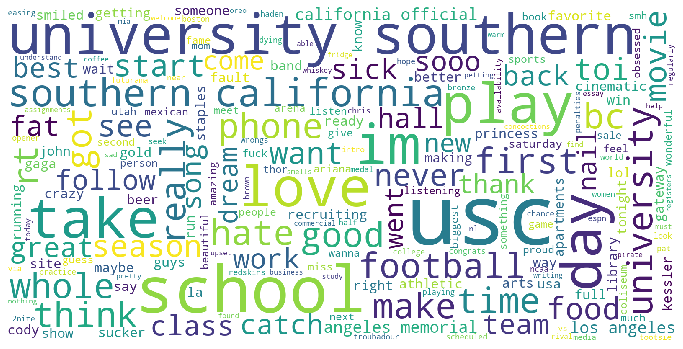

In [93]:
wcg = WordCloudGeneration(word_index, 'tweetconcat', ngram_size=0)
wcg.create_word_cloud(predictions, 16)

# Approach 2 (Classify messages individually then aggregate the scores)

In [94]:
doc_tokenizer = DocumentTokenizer('tweet', maxlen=300, word_index=word_index)
predictor = ClusterClassPredictor(model, doc_tokenizer, categories_encoder.classes_, classes, 0.05)
data = clustered_tweets.groupby("cluster").filter(is_valid_polygon)
predictions = predictor.transform(data)
predictions.head(10)

,cluster,location_geometry,tweet,category,scores,predictions
id,,,,,,
383430944650055680,0,POINT (-118.28854 34.01361),#WeLoveLA Pat Haden meets with NCAA to seek ea...,sports,"[5.215380838308192e-08, 1.9760376744670793e-05...","[(Sports, Fitness & Dieting, 0.9963266)]"
383292826219335681,0,POINT (-118.28236 34.03101),Oh! Got it :) “@_R0YAL_: @cy_dieyi d legoo is ...,music,"[2.166084414056968e-07, 0.0007095527835190296,...","[(Music, 0.9901991)]"
383368197853810688,91,POINT (-118.56850 34.20653),“@justincepriano: I don't understand how peopl...,games,"[7.913026678352253e-08, 6.210858373378869e-06,...","[(Toys & Games, 0.99196494)]"
383144905704763392,6,POINT (-118.29150 34.10218),Electric Lotus Indian good here in Los Feliz.....,music,"[3.6212550185155123e-06, 0.0026956230867654085...","[(Music, 0.99125177)]"
383127851634921472,0,POINT (-118.28243 34.03161),@NDTdance @MusicCenterLA Toi toi toi for NL se...,music,"[1.1739555105805266e-07, 5.27757583768107e-05,...","[(Music, 0.9993032)]"
383299646157623296,57,POINT (-118.44095 34.06022),Hi @zico @C2Ococonutwater @onecoconut @VitaCoc...,health,"[1.9131967121666094e-07, 9.988795682147611e-06...","[(Health & Personal Care, 0.98332745)]"
383124454278053888,6,POINT (-118.30261 34.07847),I know I've seen Clueless but this time feels ...,movies,"[3.5319505968800513e-06, 5.3170158935245126e-0...","[(Movies & TV, 0.99688834)]"
383284118819049472,57,POINT (-118.44399 34.07271),Beyoncé plays in the hallways at ucla..I can d...,music,"[5.8020479087872445e-08, 8.588858690927736e-06...","[(Music, 0.9989249)]"
383373717536927744,101,POINT (-118.55611 34.23456),Hearing The Germs on an MTV show.... What a tr...,music,"[3.2221741719240526e-08, 6.3199659052770585e-0...","[(Music, 0.99797386)]"


In [95]:
predictions.iloc[5]['tweet']

'Hi @zico @C2Ococonutwater @onecoconut @VitaCoco. im looking for a #coconut brand that wants to be included in my YouTube videos.'

In [96]:
class ClusterScoreAggregator(BaseEstimator, TransformerMixin):

    def __init__(self, agg_column, score_column, classes, class_labels, threshold, exclude_noise=True):
        self.agg_column = agg_column
        self.score_column = score_column
        self.classes = classes
        self.class_labels = class_labels
        self.exclude_noise = exclude_noise
        self.threshold = threshold

    def fit(self, X, y=None):
        return self

    def __inclusion_fn(self, clazz, score):
        if score > self.threshold:
            if self.exclude_noise and clazz == 'na':
                return False
            else:
                return True
        return False

    def transform(self, X, y=None):
        data = X.groupby(self.agg_column).filter(is_valid_polygon)

        def aggregate_scores(values):
            values = np.array(values.tolist())
            return np.mean(values, axis=0).tolist()

        data = data.groupby(self.agg_column).agg({'location_geometry': ['count', calculate_polygon],
                                    self.score_column: [aggregate_scores],
                                    'tweet': [concatenate_text()]})
        colnames = {'location_geometrycalculate_polygon': 'polygon', 
            'location_geometrycount': 'size', 
            f'{self.score_column}aggregate_scores': 'aggregate_predictions'
        }
        data = flat_columns(data, colnames)
        predictions = [list(zip(self.classes, p)) for p in data['aggregate_predictions'].values]
        predictions = [[(self.class_labels[c], s) for c, s in p if self.__inclusion_fn(c, s)] for p in predictions]
        predictions = [sorted(p, key=lambda x: x[1], reverse=True) for p in predictions]
        data['predictions'] = predictions
        return data

In [97]:
csa = ClusterScoreAggregator('cluster', 'scores', categories_encoder.classes_, classes, 0.05)
agg_predictions = csa.transform(predictions)
agg_predictions = agg_predictions.reset_index()
agg_predictions.head()

,cluster,size,polygon,aggregate_predictions,tweetconcat,predictions
0,0,168,"POLYGON ((-118.29319 34.03389, -118.29507 34.0...","[0.029270882243960322, 0.05049572868413152, 0....",#WeLoveLA Pat Haden meets with NCAA to seek ea...,"[(Music, 0.23728489945884776), (Sports, Fitnes..."
1,1,3,"POLYGON ((-118.28661 34.00079, -118.28765 34.0...","[2.882782817437146e-05, 0.0013567887557049592,...",@EASTBAYDFRESH Baseball gods ain't liking you ...,"[(Health & Personal Care, 0.33325954524237505)..."
2,2,18,"POLYGON ((-118.30429 34.02154, -118.30009 34.0...","[0.0006811286772346511, 0.039443184795446645, ...",Ima walk up into school like I'm on my high wa...,"[(Other Products, 0.2795143283712807), (Music,..."
3,3,29,"POLYGON ((-118.28125 34.05117, -118.28802 34.0...","[0.0006350418398339447, 0.03476941521241064, 0...",Wifi Crisis day three http://t.co/EkftIFG5bi.\...,"[(Sports, Fitness & Dieting, 0.299034486693236..."
4,4,12,"POLYGON ((-118.28826 34.05443, -118.28834 34.0...","[0.0006372600333151013, 0.16445735495638777, 0...",All I ask for is a fucked up sleeping schedule...,"[(Other Products, 0.2686841869048446), (Music,..."


In [118]:
min_size = 10
clusters_to_plot = agg_predictions[agg_predictions["size"] >= min_size]
displayed = [57, 76, 6, 26, 88]
la_cl_map = display_cluster_polygons_on_map(clusters_to_plot, displayed)
la_cl_map

In [119]:
la_cl_map.save(os.path.join(results_path, 'la_clusters.html'))

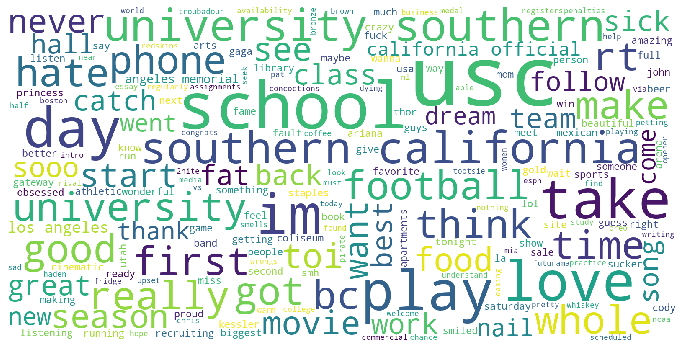

In [99]:
wcg = WordCloudGeneration(word_index, 'tweetconcat', ngram_size=0)
wcg.create_word_cloud(agg_predictions, 88)

### Conclusion
Computing separate scores and aggregating them gives more diverse results and the obtained word cloud seems a bit more reasonable when compared with the clusters this way.

## Now offer a temporal shift perspective

In [100]:
def prepare_subset_by_month(tweets, month):
    tweets = tweets.loc[tweets['month'] == month]
    tweets = tweets.loc[tweets['location_geometry'].notnull()]
    tweets.loc[:, 'location_geometry'] = tweets['location_geometry'].apply(parse_geometry)
    return tweets

In [101]:
%%time
july = prepare_subset_by_month(la_tweets, 7)
august = prepare_subset_by_month(la_tweets, 8)
september = prepare_subset_by_month(la_tweets, 9)

CPU times: user 367 ms, sys: 44.6 ms, total: 411 ms
Wall time: 410 ms


Calculate the clusters for each month

In [102]:
def get_points(tweets):
    points = tweets.loc[tweets['location_geometry'].notnull()]['location_geometry'].apply(lambda p: [p.x, p.y])
    return np.array(points.values.tolist())

def calculate_clusters(points):
    optics = OPTICS(cluster_method="dbscan",
                    eps=0.004,
                    min_samples=10,
                    metric="minkowski",
                    n_jobs=-1).fit(points)
    return optics

In [103]:
%%time

july_clusters_path = os.path.join(sklearn_models, 'july_clusters.pkl')
july_clusters = None
if os.path.exists(july_clusters_path):
    with open(july_clusters_path, 'rb') as file:
        july_clusters = pickle.load(file)
else:
    july_points = get_points(july)
    july_clusters = calculate_clusters(july_points)
    with open(july_clusters_path, 'wb') as file:
        pickle.dump(july_clusters, file)

CPU times: user 0 ns, sys: 1.15 ms, total: 1.15 ms
Wall time: 2.27 ms


In [104]:
%%time

august_clusters_path = os.path.join(sklearn_models, 'august_clusters.pkl')
august_clusters = None
if os.path.exists(august_clusters_path):
    with open(august_clusters_path, 'rb') as file:
        august_clusters = pickle.load(file)
else:
    august_points = get_points(august)
    august_clusters = calculate_clusters(august_points)
    with open(august_clusters_path, 'wb') as file:
        pickle.dump(august_clusters, file)

CPU times: user 0 ns, sys: 1.46 ms, total: 1.46 ms
Wall time: 2.72 ms


In [105]:
%%time

september_clusters_path = os.path.join(sklearn_models, 'september_clusters.pkl')
september_clusters = None
if os.path.exists(september_clusters_path):
    with open(september_clusters_path, 'rb') as file:
        september_clusters = pickle.load(file)
else:
    september_points = get_points(september)
    september_clusters = calculate_clusters(september_points)
    with open(september_clusters_path, 'wb') as file:
        pickle.dump(september_clusters, file)

CPU times: user 1.12 ms, sys: 86 µs, total: 1.2 ms
Wall time: 2.17 ms


In [106]:
def prepare_clustered_tweets(tweets, clusters):
    """"For usage in text aggregation prediction"""
    clustered_tweets = tweets[tweets['location_geometry'].notnull()]
    clustered_tweets.loc[:, 'cluster'] = clusters.labels_
    clustered_tweets = clustered_tweets[["cluster", "location_geometry", "tweet"]]
    clustered_tweets = clustered_tweets[clustered_tweets.cluster != -1]
    data = clustered_tweets.groupby("cluster").filter(is_valid_polygon)
    data = data.groupby("cluster").agg({'location_geometry': ['count', calculate_polygon],
                                'tweet': [concatenate_text()]})
    colnames = {'location_geometrycalculate_polygon': 'polygon', 'location_geometrycount': 'size'}
    data = flat_columns(data, colnames)
    return data

In [107]:
def prepare_clustered_scores(tweets, clusters, predictor, aggregator):
    """For usage in score aggregation prediction"""
    clustered_tweets = tweets[tweets['location_geometry'].notnull()]
    clustered_tweets.loc[:, 'cluster'] = clusters.labels_
    clustered_tweets = clustered_tweets[clustered_tweets.cluster != -1]
    predictions = predictor.transform(clustered_tweets)
    predictions = clustered_tweets.groupby("cluster").filter(is_valid_polygon)
    agg_predictions = aggregator.transform(predictions)
    return agg_predictions.reset_index()

In [108]:
# clustered_july = prepare_clustered_tweets(july, july_clusters)
# clustered_august = prepare_clustered_tweets(august, august_clusters)
# clustered_september = prepare_clustered_tweets(september, september_clusters)

# july_predictions = predictor.transform(clustered_july).reset_index()
# august_predictions = predictor.transform(clustered_august).reset_index()
# september_predictions = predictor.transform(clustered_september).reset_index()

In [109]:
%%time
doc_tokenizer = DocumentTokenizer('tweet', maxlen=300, word_index=word_index)
predictor = ClusterClassPredictor(model, doc_tokenizer, categories_encoder.classes_, classes, 0.05)
csa = ClusterScoreAggregator('cluster', 'scores', categories_encoder.classes_, classes, 0.05)

july_predictions = prepare_clustered_scores(july, july_clusters, predictor, csa)
august_predictions = prepare_clustered_scores(august, august_clusters, predictor, csa)
september_predictions = prepare_clustered_scores(september, september_clusters, predictor, csa)

CPU times: user 10.6 s, sys: 249 ms, total: 10.9 s
Wall time: 10.5 s


## Los Angeles - July 2013

In [110]:
min_size = 10
clusters_to_plot = july_predictions[july_predictions["size"] >= min_size]
displayed = []
la_cl_map = display_cluster_polygons_on_map(clusters_to_plot, displayed)
la_cl_map

## Los Angeles - August 2013

In [111]:
min_size = 10
clusters_to_plot = august_predictions[august_predictions["size"] >= min_size]
displayed = [2, 83, 13, 127, 107]
la_cl_map = display_cluster_polygons_on_map(clusters_to_plot, displayed)
la_cl_map

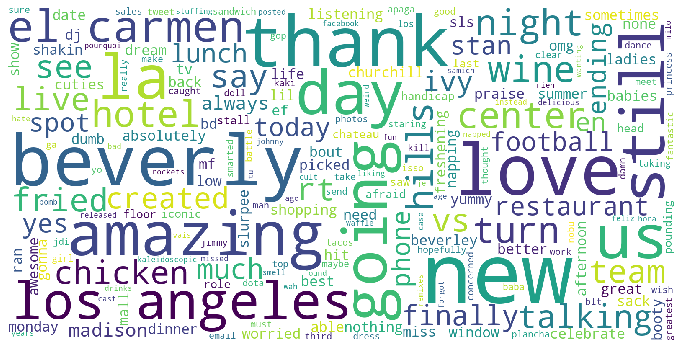

In [112]:
wcg = WordCloudGeneration(word_index, 'tweetconcat', ngram_size=0)
wcg.create_word_cloud(august_predictions, 13)

## Los Angeles - September 2013

In [113]:
min_size = 10
clusters_to_plot = september_predictions[september_predictions["size"] >= min_size]
displayed = [16, 28, 123, 4]
la_cl_map = display_cluster_polygons_on_map(clusters_to_plot, displayed)
la_cl_map

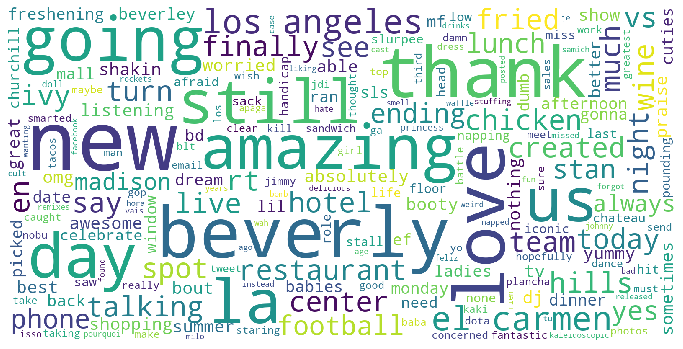

In [114]:
wcg = WordCloudGeneration(word_index, 'tweetconcat', ngram_size=0)
wcg.create_word_cloud(august_predictions, 16)